Dimensions de K: (22, 22)
Dimensions de M: (22, 22)
3.5039296140975673
26.716547863242866
84.54117688603843
146.91373285715113
288.2392499190401
t = 0.0
t = 1.6928431980790588e-06
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 0.0
t = 2.6247707424813093e-05
t = 0.00010917974842151159
t = 0.00016928431980790587
t = 2.6247707424813093e-05
t = 0.00010917974842151159
t = 0.00016928431980790587
t = 6.103355967089844e-06
t = 2.538746939795051e-05
t = 3.9363531706300444e-05
t = 6.103355967089844e-06
t = 2.538746939795051e-05
t = 3.9363531706300444e-05
t = 0.0
t = 4.3249532508721734e-06
t = 1.7990040052741298e-05
t = 2.7893741629516837e-05
t = 4.3249532508721734e-06
t = 1.7990040052741298e-05
t = 2.7893741629516837e-05
t = 0.0
t 

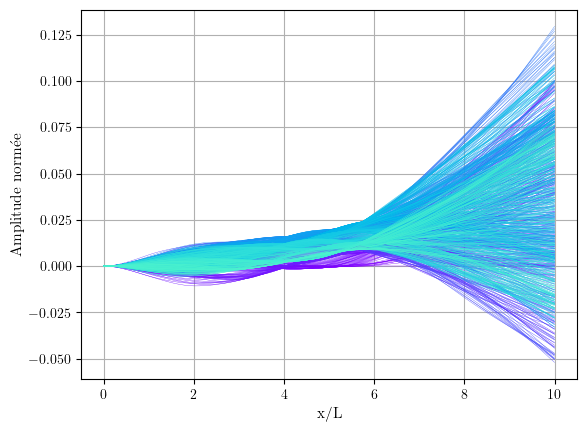

[3.5039296140975673, 26.716547863242866, 84.54117688603843, 146.91373285715113, 288.2392499190401]
[20.742562999100564, 108.45737843753668, 336.0421983398147, 679.6216789423771, 1064.5455011089243]
epsilon - convergence fréquences
4.919800134011192
delta - convergence vecteurs propres
4.8618388337844936

======= ANALYSE DE CONVERGENCE DES FRÉQUENCES =======
N = 5  |  Erreur max : 2.737%
N = 10  |  Erreur max : 2.211%
N = 20  |  Erreur max : 1.376%
N = 40  |  Erreur max : 0.702%
N = 80  |  Erreur max : 0.347%
N = 160  |  Erreur max : 0.171%
N = 320  |  Erreur max : 0.085%

======= ANALYSE DE CONVERGENCE DES MODES PROPRES =======
N = 5  |  Erreur max : 0.343%
N = 10  |  Erreur max : 0.201%
N = 20  |  Erreur max : 0.129%
N = 40  |  Erreur max : 0.040%
N = 80  |  Erreur max : 0.010%
N = 160  |  Erreur max : 0.003%
N = 320  |  Erreur max : 0.001%


In [12]:
import scipy.integrate as integrate
from scipy.integrate import solve_ivp
from scipy.integrate import odeint
import numpy as np
import matplotlib.pyplot as plt
import math as mt
import scipy.linalg as la
import sys
from scipy.optimize import fsolve
from Chargement_module import Chargement
from Modes_EF_module import Modes_EF
import matplotlib.pyplot as plt
from scipy.linalg import eig
import numpy as np

# #########################################################################
# Dimension de l'aile et propriétés
Longueur = 10.0       # Longueur de l’aile (m)
Largeur = 2.0         # Largeur (corde) (m)
Epaisseur = 0.3       # Épaisseur (m)
Paroi = 0.05          # Épaisseur des parois (m)

# Matériau (Aluminium)
E = 70e9              # Module d’élasticité (Pa)
RHO = 2700            # Masse volumique (kg/m^3)

# Aire de la section (rectangle creux)
A = (Largeur * Epaisseur) - (Largeur - 2 * Paroi) * (Epaisseur - 2 * Paroi)

# Moment d'inertie de la section creuse (approché par superposition)
I = 2 * ( (1/12) * (Largeur * Paroi**3) + Largeur * Paroi * (Epaisseur/2 - Paroi/2)**2 ) \
    + 2 * ( (1/12) * Paroi * (Epaisseur - 2*Paroi)**3 )

# Moteur
LM = 4.0              # Emplacement du moteur en m
MM = 1000.0           # Masse du moteur en kg

# Carburant
LC1 = 2.0             # Début zone de carburant en m
LC2 = 6.0             # Fin zone de carburant en m
MC = 304.0            # Masse linéique du carburant en kg/m


# #########################################################################
# Maillage
Nb_Elements = 10
L = Longueur/Nb_Elements
DDL = 2*(Nb_Elements+1)

# Matrice de rigidité et de masse d'une poutre %%% À compléter %%%
# Matrice de rigidité d’un élément poutre
K_poutre = (E*I/L**3)*np.array([
    [12,      6*L,    -12,     6*L],
    [6*L,  4*L**2,  -6*L,  2*L**2],
    [-12,    -6*L,     12,    -6*L],
    [6*L,  2*L**2,  -6*L,  4*L**2]
])

# Matrice de masse d’un élément poutre
M_poutre = (RHO*A*L/420)*np.array([
    [156,      22*L,    54,     -13*L],
    [22*L,  4*L**2,  13*L,   -3*L**2],
    [54,       13*L,   156,    -22*L],
    [-13*L, -3*L**2, -22*L,  4*L**2]
])


# Matrice de rigidité et de masse globale du système %%% À compléter %%%
K = np.zeros((DDL,DDL))
M = np.zeros((DDL,DDL))
for i in range(0,DDL-3,2):
    K[i:i+4, i:i+4] += K_poutre
    M[i:i+4, i:i+4] += M_poutre 

print("Dimensions de K:", K.shape)
print("Dimensions de M:", M.shape)
# Ajout de la masse du moteur %%% À compléter %%%
Noeud = round(LM/L)
M[2*Noeud, 2*Noeud] += MM
 

# Ajout de la masse du carburant
Noeud1 = round(LC1/L)
Noeud2 = round(LC2/L)
# print(Noeud,Noeud1,Noeud2) %%% À compléter %%%
for i in range(2*Noeud1+2,2*Noeud2-1,2):
     M[i:i+4,i:i+4] += MC * M_poutre  

# Conditions aux rives
K = K[2:,2:]
M = M[2:,2:]
Nb_DDL = len(K)
# print(DDL,Nb_DDL)

# #########################################################################
# Calcul des fréquences propres (numériquement) %%% À compléter %%%

LAMBDA, PHI = la.eig(K, M)

# Extraction des fréquences naturelles (triées, en rad/s)
OMEGA = sorted(np.sqrt(np.real(LAMBDA)))

# Normalisation des vecteurs propres pour que PHIᵀ M PHI ≈ I
Mm = np.diag(np.diag(PHI.T @ M @ PHI))
PHI = PHI @ np.sqrt(np.linalg.inv(Mm))

# Réorganisation des colonnes de PHI en fonction des fréquences croissantes
indices_tri = np.argsort(np.sqrt(np.real(LAMBDA)))
PHI = PHI[:, indices_tri]

# Ajout des deux DDL fixes (v = θ = 0 à l'encastrement)
PHI = np.block([[np.zeros((2, Nb_DDL))], [PHI]])


# #########################################################################
# Calcul des modes propres (numériquement)
# Discrétisation de l'aile en 100 points
Nb_Points = 100
x = np.linspace(0,Longueur,Nb_Points)

v_FEM = np.zeros((Nb_Points,DDL))
#Calcul des modes propres
v_FEM = Modes_EF(PHI,x,Longueur,Nb_Elements)
# #########################################################################
# Impression des résultats
# Tracage des 5 premier Modes
Nb_Modes = 5
for i in range(Nb_Modes):
    print(OMEGA[i])
couleur = iter(plt.cm.rainbow(np.linspace(0,0.4,Nb_Modes)))

# #########################################################################
# Intégration temporelle
# Temps de simulation
Temps = 4.
# Nombre de pas de temps
n = 5000
# time points
t = np.linspace(0,Temps,n)
# Type de chargement (1 pour Balourd et 2 pour pour Rafale de vent)
Type = 2
# Amortissement
C = 0.8*M
# fonction qui retourne la dérivée temporelle (dz/dt)
def model(t,z,invm,invmc,invmk,n,Type):
    print('t =', t)
    xl = np.zeros(n)
    yl = np.zeros(n)
    dzdt = np.zeros(2*n)
    u = np.zeros(Nb_DDL)
    if Type == 1:
        # Terme de forçage de type Balourd à l'emplacement du moteur
        w = 10000*np.pi/30
        mb = 0.5
        e = 0.3
        u[2*Noeud-2] = mb*e*w**2*np.sin(w*t)
    for i in range(n):
        xl[i] = z[2*i]
        yl[i] = z[2*i+1]
    dxdt = yl
    dydt = - invmc @ yl - invmk @ xl + invm @ u
    for i in range(n):
        dzdt[2*i]   = dxdt[i]
        dzdt[2*i+1] = dydt[i]
    return dzdt
# Calculs préliminaires des matrices du système pour alléger le coût d'évaluation de la solution
invM  = np.linalg.inv(M)
invMC = np.linalg.inv(M)@C
invMK = np.linalg.inv(M)@K
# plage de temps de résolution
tspan = [t[0],t[n-1]]
# visualisation des N_vis derniers pas de temps
N_vis = 1000
# initial condition
z0 = np.zeros(2*Nb_DDL)
if Type == 2:
    # Rafale de vent Conditions initiales
    Impulsion = np.zeros((Nb_DDL))
    for i in range(0,Nb_DDL,2):
        Impulsion[i] = 3100
    Impulsion[0] = 3100/2.
    Impulsion[1] = 3100/12.
    Impulsion[Nb_DDL-2] = 3100/2.
    Impulsion[Nb_DDL-1] = -3100/12.
    # Définition des conditions initiales (vitesse non nulle - impulsion)
    ydep = np.zeros((Nb_DDL))
    Impulsion = np.linalg.inv(M)@Impulsion
    for i in range(Nb_DDL):
        z0[2*i+1] = Impulsion[i]
# résolution du système d'EDO couplées
z = solve_ivp(model, tspan, z0, method='Radau', args=(invM, invMC, invMK, Nb_DDL, Type), t_eval=t)

# enregistrement de la solution pour visualisation
x_sol = np.zeros((N_vis,Nb_DDL))
v_sol = np.zeros((N_vis,Nb_DDL))
k = 0
for i in range(n-N_vis-1,n-1):
    for j in range(Nb_DDL):
        x_sol[k,j] = z.y[2*j,k]
        v_sol[k,j] = z.y[2*j+1,k]
    k += 1
# Calcul de la flèche de la poutre en fonction du temps
Chargement(x_sol,Longueur,Nb_Elements)

# ################################################################
# Analyse de convergence 
# Maillage
Nb_Elements1 = 2*Nb_Elements
L1 = Longueur/Nb_Elements1
DDL1 = 2*(Nb_Elements1+1)

# Matrice de rigidité et de masse d'une poutre    %%% A compléter %%%
K_poutre1 = (E*I/L1**3)*np.array([[12, 6*L1, -12, 6*L1],[6*L1,4*L1**2,-6*L1,2*L1**2],[-12,-6*L1,12,-6*L1],[6*L1,2*L1**2,-6*L1,4*L1**2]])
M_poutre1 = (L1/420)*np.array([[156,22*L1,54,-13*L1],[22*L1,4*L1**2,13*L1,-3*L1**2],[54,13*L1,156,-22*L1],[-13*L1,-3*L1**2,-22*L1,4*L1**2]])

# Matrice de rigidité et de masse globale du système    %%% A compléter %%%
K1 = np.zeros((DDL1,DDL1))
M1 = np.zeros((DDL1,DDL1)) #Bloc 4x4 décalé de 2 ddl, on ne doit pas écraser les termes élémentaires, on ajoute par dessus 
for i in range(0,DDL1-3,2):
    K1[i:i+4,i:i+4] = K1[i:i+4,i:i+4] + K_poutre1
    M1[i:i+4,i:i+4] = M1[i:i+4,i:i+4] + RHO*A*M_poutre1

# Ajout de la masse du moteur   %%% A compléter %%%
Noeud3 = round(LM/L1)
M1[2*Noeud3,2*Noeud3] = M1[2*Noeud3,2*Noeud3] + MM

# Ajout de la masse du carburant
Noeud4 = round(LC1/L1)
Noeud5 = round(LC2/L1)
for i in range(2*Noeud4+2,2*Noeud5-1,2):
    M1[i:i+4,i:i+4] = M1[i:i+4,i:i+4] + MC*M_poutre1

#% Conditions aux rives
K1 = K1[2:,2:]
M1 = M1[2:,2:]

Nb_DDL = len(K1)
# print(DDL,Nb_DDL)

# #########################################################################
# Calcul des fréquences propres (numériquement)
LAMBDA1, PHI1 = la.eig(K1,M1)
# print("PHI est normalisée par la.eig (norme euclidienne)")
OMEGA1 = sorted(np.sqrt(np.real(LAMBDA1)))
# print("OMEGA: Les 5 fréquences naturelles les plus basses en rad/s sont")
Mm1=np.diag(np.diag(PHI1.transpose()@M1@PHI1))
PHI1=PHI1@np.sqrt(np.linalg.inv(Mm1))
# Verification: Mm doit être la matrice unitaire I
# print("Matrice masse modale")
# Mm = PHI.transpose()@M@PHI
indices_tri1 = np.argsort(np.sqrt(np.real(LAMBDA1)))
PHI1 = PHI1[:, indices_tri1]

PHI1 = np.block([[np.zeros((2,Nb_DDL))],[PHI1]])

print(OMEGA[0:5])
print(OMEGA1[0:5])

# eps = np.max(abs((OMEGA1[0:4]-OMEGA[0:4])/OMEGA[0:4]))
eps =np.zeros(5)
for i in range(5):
    eps[i] = abs((OMEGA1[i]-OMEGA[i])/OMEGA[i])
print('epsilon - convergence fréquences')
print(max(eps))

# #########################################################################
# Calcul des modes propres (numériquement)
# Discrétisation de l'aile en 100 points
Nb_Points = 100
x = np.linspace(0,Longueur,Nb_Points)

v_FEM1 = np.zeros((Nb_Points,DDL))
# Calcul des modes propres
v_FEM1 = Modes_EF(PHI1,x,Longueur,Nb_Elements1)
#Analyse de convergence des modes propres

delta = 0.
for i in range(5):
    delta = delta + np.max(sum((v_FEM1[1:100,i]-v_FEM[1:100,i])**2)/sum((v_FEM[1:100,i])**2))
print('delta - convergence vecteurs propres')
print(delta)

# ANALYSE DE CONVERGENCE - FRÉQUENCES PROPRES ET MODES PROPRES (EF)


# =====================
# Fonction assemblage EF pour un N donné
# =====================
def assemble_K_M_EF(Nb_Elements):
    L = Longueur / Nb_Elements
    DDL = 2 * (Nb_Elements + 1)
    K_poutre = (E*I/L**3)*np.array([[12, 6*L, -12, 6*L],
                                    [6*L, 4*L**2, -6*L, 2*L**2],
                                    [-12, -6*L, 12, -6*L],
                                    [6*L, 2*L**2, -6*L, 4*L**2]])
    M_poutre = (L/420)*np.array([[156, 22*L, 54, -13*L],
                                  [22*L, 4*L**2, 13*L, -3*L**2],
                                  [54, 13*L, 156, -22*L],
                                  [-13*L, -3*L**2, -22*L, 4*L**2]])
    K = np.zeros((DDL, DDL))
    M = np.zeros((DDL, DDL))
    for i in range(0, DDL - 3, 2):
        K[i:i+4, i:i+4] += K_poutre
        M[i:i+4, i:i+4] += RHO * A * M_poutre
    noeud_moteur = round(LM / L)
    M[2*noeud_moteur, 2*noeud_moteur] += MM
    noeud1 = round(LC1 / L)
    noeud2 = round(LC2 / L)
    for i in range(2*noeud1+2, 2*noeud2-1, 2):
        M[i:i+4, i:i+4] += MC * M_poutre
    return K[2:, 2:], M[2:, 2:], Nb_Elements

# =====================
# Fonction pour extraire les fréquences
# =====================
def get_frequencies(K, M):
    LAMBDA, _ = eig(K, M)
    return np.array(sorted(np.sqrt(np.real(LAMBDA))))[:5]

# =====================
# Fonction pour extraire les modes interpolés
# =====================
def get_modes(K, M, Nb_Elements):
    _, PHI = eig(K, M)
    idx = np.argsort(np.sqrt(np.real(_)))
    PHI = PHI[:, idx]
    PHI = np.block([[np.zeros((2, PHI.shape[1]))], [PHI]])
    x = np.linspace(0, Longueur, 100)
    v = Modes_EF(PHI, x, Longueur, Nb_Elements)
    return v[:, :5]

# =====================
# Analyse convergence des fréquences
# =====================
print("\n======= ANALYSE DE CONVERGENCE DES FRÉQUENCES =======")
N_vals = []
epsilons = []
N = 5
while N <= 320:
    K1, M1, _ = assemble_K_M_EF(N)
    K2, M2, _ = assemble_K_M_EF(2*N)
    omega1 = get_frequencies(K1, M1)
    omega2 = get_frequencies(K2, M2)
    erreur = np.abs((omega2 - omega1) / omega1)
    eps_max = np.max(erreur)
    print(f"N = {N}  |  Erreur max : {eps_max*100:.3f}%")
    N_vals.append(N)
    epsilons.append(eps_max)
    N *= 2



# =====================
# Analyse convergence des modes
# =====================
print("\n======= ANALYSE DE CONVERGENCE DES MODES PROPRES =======")
N_vals = []
deltas = []
N = 5
while N <= 320:
    K1, M1, n1 = assemble_K_M_EF(N)
    K2, M2, n2 = assemble_K_M_EF(2*N)
    vN = get_modes(K1, M1, n1)
    v2N = get_modes(K2, M2, n2)
    erreurs = []
    for i in range(5):
        err = np.sum((v2N[:, i] - vN[:, i])**2) / np.sum(vN[:, i]**2)
        erreurs.append(err)
    delta = max(erreurs)
    print(f"N = {N}  |  Erreur max : {delta*100:.3f}%")
    N_vals.append(N)
    deltas.append(delta)
    N *= 2


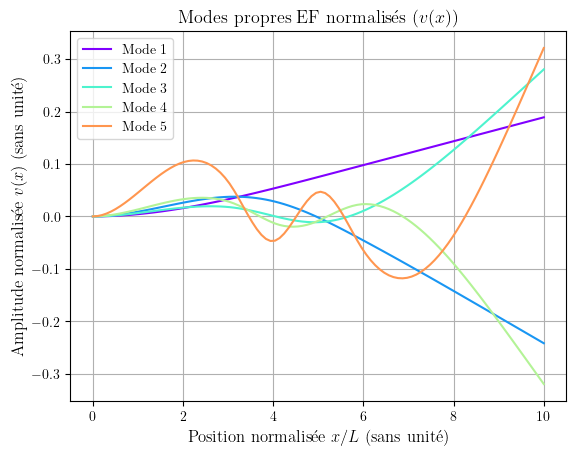

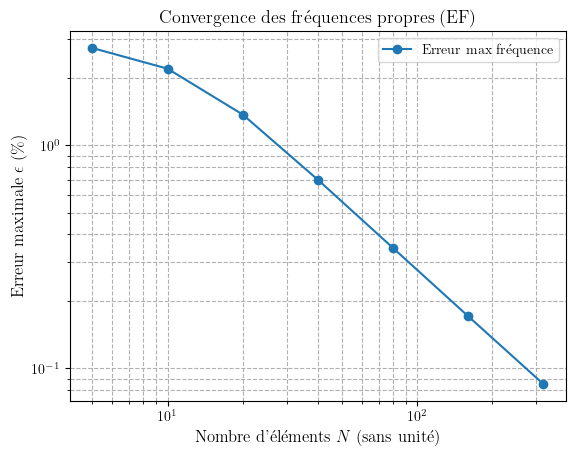

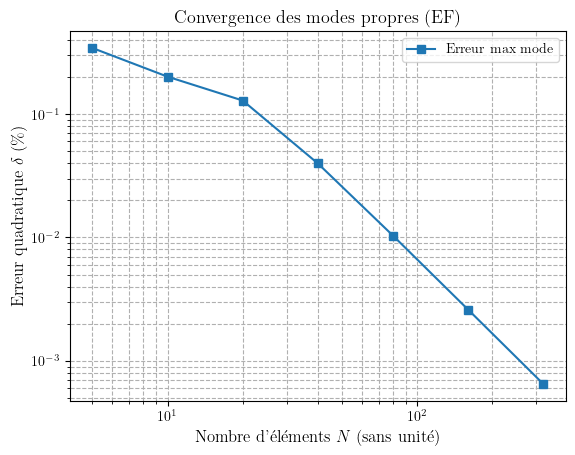

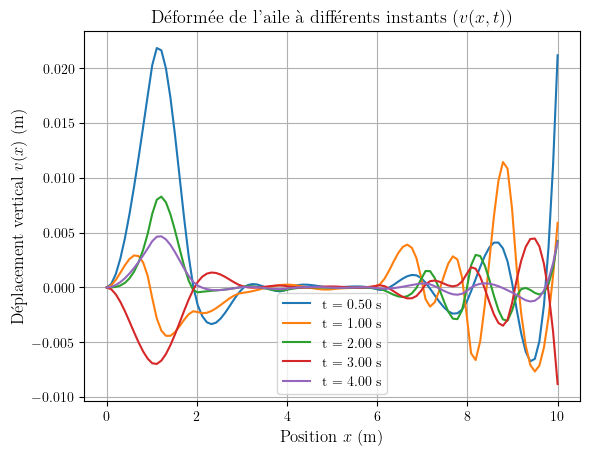

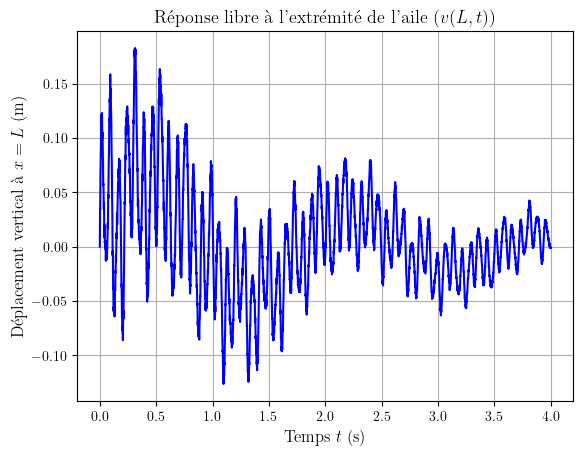

In [13]:

# modes propres EF --
plt.rc('text', usetex=True)
plt.rc('font', family='serif')
couleur = iter(plt.cm.rainbow(np.linspace(0, 0.8, Nb_Modes)))
plt.figure()
for i in range(Nb_Modes):
    c = next(couleur)
    plt.plot(x[:], v_FEM[:, i], '-', label=f'Mode {i+1}', color=c)

plt.xlabel(r'Position normalisée $x/L$ (sans unité)', fontsize=12)
plt.ylabel(r'Amplitude normalisée $v(x)$ (sans unité)', fontsize=12)
plt.title(r'Modes propres EF normalisés ($v(x)$)', fontsize=13)
plt.grid(True)
plt.legend()
plt.savefig('modes_EF.png', dpi=300, bbox_inches='tight')
plt.show()

#Convergence des fréquences EF (log-log) --
plt.figure()
plt.loglog(N_vals, np.array(epsilons)*100, 'o-', label="Erreur max fréquence")
plt.xlabel("Nombre d'éléments $N$ (sans unité)", fontsize=12)
plt.ylabel("Erreur maximale $\epsilon$ (\%)", fontsize=12)
plt.title("Convergence des fréquences propres (EF)", fontsize=13)
plt.grid(True, which='both', linestyle='--')
plt.legend()
plt.savefig("convergence_frequences_EF.png", dpi=300)
plt.show()
# -- 3. Convergence des modes EF (log-log) --
plt.figure()
plt.loglog(N_vals, np.array(deltas)*100, 's-', label="Erreur max mode")
plt.xlabel("Nombre d'éléments $N$ (sans unité)", fontsize=12)
plt.ylabel("Erreur quadratique $\delta$ (\%)", fontsize=12)
plt.title("Convergence des modes propres (EF)", fontsize=13)
plt.grid(True, which='both', linestyle='--')
plt.legend()
plt.savefig("convergence_modes_EF.png", dpi=300)
plt.show()

# -- 4. Forme à différents instants t (rafale) --
temps_voulus = [0.5, 1.0, 2.0, 3.0, 4.0]
t_indices = [np.argmin(np.abs(z.t - tv)) for tv in temps_voulus]
x_visu = np.linspace(0, Longueur, 100)
forme = Modes_EF(PHI, x_visu, Longueur, Nb_Elements)

plt.figure()
for idx in t_indices:
    deformation = forme @ z.y[::2, idx]
    plt.plot(x_visu, deformation, label=f"t = {z.t[idx]:.2f} s")

plt.xlabel("Position $x$ (m)", fontsize=12)
plt.ylabel("Déplacement vertical $v(x)$ (m)", fontsize=12)
plt.title("Déformée de l’aile à différents instants ($v(x,t)$)", fontsize=13)
plt.grid(True)
plt.legend()
plt.savefig("forme_temporelle_poutre.png", dpi=300)
plt.show()

# -- 5. Déplacement de l’extrémité libre vs temps (rafale) --
x_extremite = np.array([Longueur])
v_extremite = Modes_EF(PHI, x_extremite, Longueur, Nb_Elements) @ z.y[::2, :]

plt.figure()
plt.plot(z.t, v_extremite[0, :], 'b-')
plt.xlabel("Temps $t$ (s)", fontsize=12)
plt.ylabel("Déplacement vertical à $x = L$ (m)", fontsize=12)
plt.title("Réponse libre à l’extrémité de l’aile ($v(L,t)$)", fontsize=13)
plt.grid(True)
plt.savefig("deplacement_extremite.png", dpi=300)
plt.show()